# Import neccesarry library

In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import xgboost as xgb

from sklearn.metrics import mean_squared_error
from ydata_profiling import ProfileReport


# set plots to show in the same size
%matplotlib inline
plt.rcParams['figure.figsize'] = (20,10)

# Read data
This for read data and see the data

In [3]:
df = pd.read_csv("data/Turbine_Data.csv",parse_dates=['Unnamed: 0'],index_col=['Unnamed: 0'])
df

,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,...,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WTG,WindDirection,WindSpeed
2017-12-31 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:10:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:20:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:30:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:40:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-03-30 23:10:00+00:00,70.044465,27.523741,45.711129,1.515669,1.950088,1.950088,0.0,59.821165,55.193793,1029.870744,...,58.148777,39.008931,36.476562,178.0,13.775785,9.234004,2.0,G01,178.0,3.533445
2020-03-30 23:20:00+00:00,40.833474,27.602882,45.598573,1.702809,2.136732,2.136732,0.0,59.142038,54.798545,1030.160478,...,57.550367,39.006759,36.328125,178.0,8.088928,9.229370,2.0,G01,178.0,3.261231
2020-03-30 23:30:00+00:00,20.777790,27.560925,45.462045,1.706214,2.139664,2.139664,0.0,58.439439,54.380456,1030.137822,...,57.099335,39.003815,36.131944,178.0,4.355978,9.236802,2.0,G01,178.0,3.331839
2020-03-30 23:40:00+00:00,62.091039,27.810472,45.343827,1.575352,2.009781,2.009781,0.0,58.205413,54.079014,1030.178178,...,56.847239,39.003815,36.007805,190.0,12.018077,9.237374,2.0,G01,190.0,3.284468


Because Unnamed: 0 is datetime, parsed it to datetime

In [4]:
df.index = pd.to_datetime(df.index)

In [5]:
df.head()

,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,...,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WTG,WindDirection,WindSpeed
2017-12-31 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:10:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:20:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:30:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:40:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN


# Describe data
See more deep about data, see the description, and check for null or outlayer value

In [6]:
df.describe()

,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,GeneratorWinding1Temperature,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WindDirection,WindSpeed
count,94750.000000,93817.000000,62518.000000,41996.000000,41891.000000,41891.000000,62160.0,62540.000000,62438.000000,62295.000000,62427.000000,62449.000000,62406.000000,62507.000000,72278.000000,94748.000000,62127.000000,6.290800e+04,72278.000000,94595.000000
mean,619.109805,28.774654,43.010189,9.749641,10.036535,10.036535,0.0,64.234170,57.561217,1102.026269,72.460403,71.826659,36.897978,39.547603,196.290539,88.133966,9.907500,2.280429e+03,196.290539,5.878960
std,611.275373,4.369145,5.545312,20.644828,20.270465,20.270465,0.0,10.455556,6.323895,528.063946,22.627489,22.650255,5.178711,5.732783,88.296554,116.596725,4.718421,3.586034e+05,88.296554,2.619084
min,-38.524659,0.000000,0.000000,-43.156734,-26.443415,-26.443415,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-203.182591,0.000000,0.000000e+00,0.000000,0.000000
25%,79.642258,25.627428,39.840247,-0.939849,-0.433264,-0.433264,0.0,57.872242,53.942181,1029.812177,55.492241,54.763998,33.943949,35.812500,145.000000,-0.432137,9.231091,2.000000e+00,145.000000,3.823330
50%,402.654893,28.340541,42.910877,0.394399,0.888977,0.888977,0.0,64.834662,57.196089,1124.860720,65.788800,65.004946,37.003815,39.491310,182.000000,35.883659,10.098702,2.000000e+00,182.000000,5.557765
75%,1074.591780,31.664772,47.007976,8.099302,8.480194,8.480194,0.0,71.079306,61.305312,1515.402005,85.867449,85.337740,40.008425,43.359375,271.000000,147.359075,13.600413,2.000000e+00,271.000000,7.506710
max,1779.032433,42.405597,55.088655,90.143610,90.017830,90.017830,0.0,82.237932,70.764581,1809.941700,126.773031,126.043018,47.996185,54.250000,357.000000,403.713620,16.273495,6.574653e+07,357.000000,22.970893


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 118224 entries, 2017-12-31 00:00:00+00:00 to 2020-03-30 23:50:00+00:00
Data columns (total 21 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   ActivePower                   94750 non-null   float64
 1   AmbientTemperatue             93817 non-null   float64
 2   BearingShaftTemperature       62518 non-null   float64
 3   Blade1PitchAngle              41996 non-null   float64
 4   Blade2PitchAngle              41891 non-null   float64
 5   Blade3PitchAngle              41891 non-null   float64
 6   ControlBoxTemperature         62160 non-null   float64
 7   GearboxBearingTemperature     62540 non-null   float64
 8   GearboxOilTemperature         62438 non-null   float64
 9   GeneratorRPM                  62295 non-null   float64
 10  GeneratorWinding1Temperature  62427 non-null   float64
 11  GeneratorWinding2Temperature  62449 non-null   float64
 12

In [8]:
df.shape

(118224, 21)

In [9]:
df.isna().sum()

ActivePower                     23474
AmbientTemperatue               24407
BearingShaftTemperature         55706
Blade1PitchAngle                76228
Blade2PitchAngle                76333
Blade3PitchAngle                76333
ControlBoxTemperature           56064
GearboxBearingTemperature       55684
GearboxOilTemperature           55786
GeneratorRPM                    55929
GeneratorWinding1Temperature    55797
GeneratorWinding2Temperature    55775
HubTemperature                  55818
MainBoxTemperature              55717
NacellePosition                 45946
ReactivePower                   23476
RotorRPM                        56097
TurbineStatus                   55316
WTG                                 0
WindDirection                   45946
WindSpeed                       23629
dtype: int64

In [10]:
df.columns

Index(['ActivePower', 'AmbientTemperatue', 'BearingShaftTemperature',
       'Blade1PitchAngle', 'Blade2PitchAngle', 'Blade3PitchAngle',
       'ControlBoxTemperature', 'GearboxBearingTemperature',
       'GearboxOilTemperature', 'GeneratorRPM', 'GeneratorWinding1Temperature',
       'GeneratorWinding2Temperature', 'HubTemperature', 'MainBoxTemperature',
       'NacellePosition', 'ReactivePower', 'RotorRPM', 'TurbineStatus', 'WTG',
       'WindDirection', 'WindSpeed'],
      dtype='object')

# Exploration Data Analysis using pandas profiling

In [11]:
# pandas_profiling.ProfileReport(df)
profile = ProfileReport(df, title="Profiling Report")

In [12]:
# profile.to_widgets()

In [13]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Handling Missing Values

In [14]:
# total number of NaN Activepower readings
total_na = df['ActivePower'].isna().sum() 
# count the number of non na values
total = df['ActivePower'].count() 
# percentage missing 
print('Percentage of missing values {}%'.format(round(total_na/total,2)*100))

Percentage of missing values 25.0%


In [15]:
# total number of NaN Activepower readings
total_na = df['WindSpeed'].isna().sum()
# count the number of non na values
total = df['WindSpeed'].count()
# percentage missing 
print('Percentage of missing values {}%'.format(round(total_na/total,2)*100))

Percentage of missing values 25.0%


## Visualizing

Text(0, 0.5, 'Power Generated')

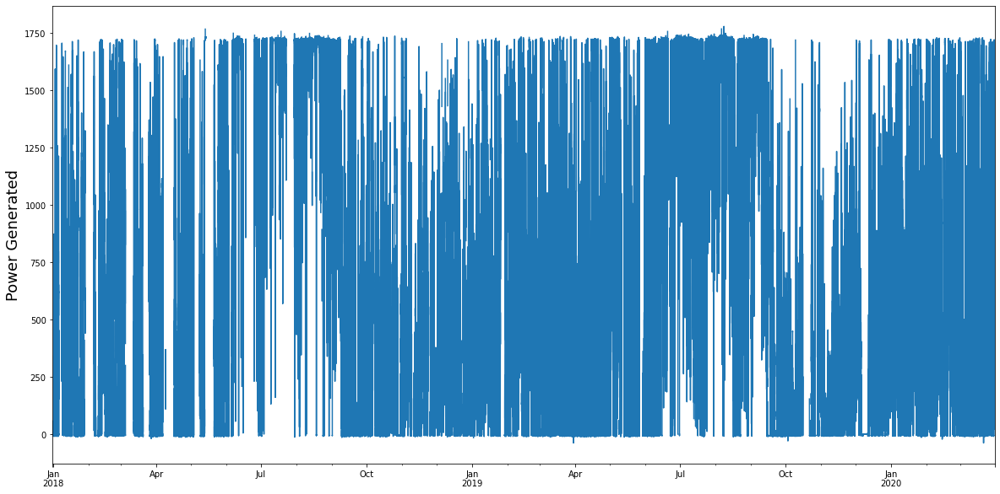

In [16]:
# Power output 
df['ActivePower'].plot()
plt.ylabel('Power Generated', fontsize=18 )

Text(0, 0.5, 'Mean Daily Power Generated')

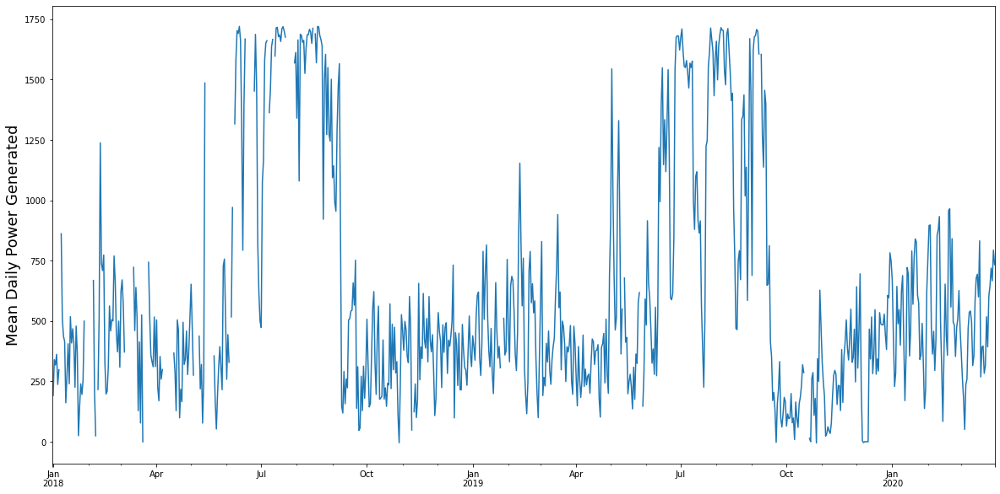

In [17]:
# Resampling daily
df['ActivePower'].resample('D').mean().plot()
plt.ylabel('Mean Daily Power Generated', fontsize=18)

Text(0, 0.5, 'Wind Speed')

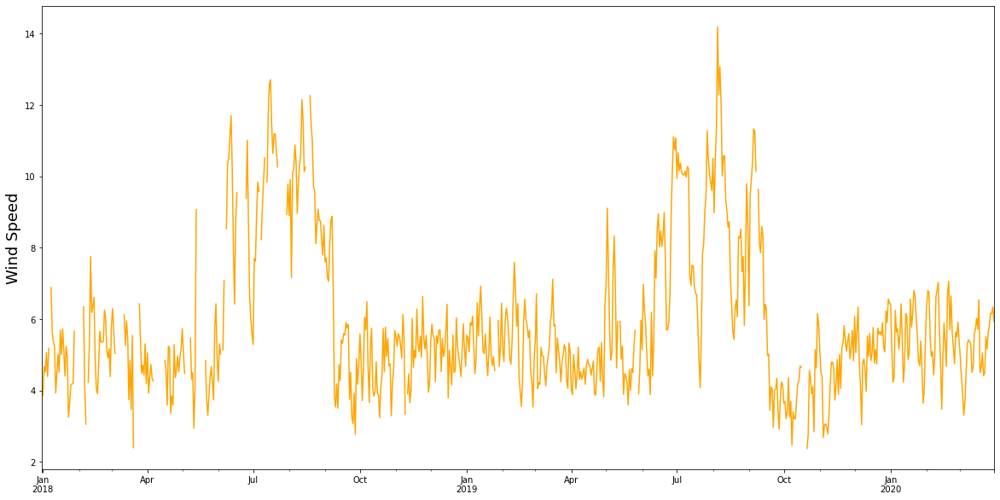

In [18]:

df['WindSpeed'].resample('D').mean().plot(color='orange')
plt.ylabel('Wind Speed', fontsize=18)

In [19]:
df

,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,...,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WTG,WindDirection,WindSpeed
2017-12-31 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:10:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:20:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:30:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:40:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-03-30 23:10:00+00:00,70.044465,27.523741,45.711129,1.515669,1.950088,1.950088,0.0,59.821165,55.193793,1029.870744,...,58.148777,39.008931,36.476562,178.0,13.775785,9.234004,2.0,G01,178.0,3.533445
2020-03-30 23:20:00+00:00,40.833474,27.602882,45.598573,1.702809,2.136732,2.136732,0.0,59.142038,54.798545,1030.160478,...,57.550367,39.006759,36.328125,178.0,8.088928,9.229370,2.0,G01,178.0,3.261231
2020-03-30 23:30:00+00:00,20.777790,27.560925,45.462045,1.706214,2.139664,2.139664,0.0,58.439439,54.380456,1030.137822,...,57.099335,39.003815,36.131944,178.0,4.355978,9.236802,2.0,G01,178.0,3.331839
2020-03-30 23:40:00+00:00,62.091039,27.810472,45.343827,1.575352,2.009781,2.009781,0.0,58.205413,54.079014,1030.178178,...,56.847239,39.003815,36.007805,190.0,12.018077,9.237374,2.0,G01,190.0,3.284468


Text(0, 0.5, 'Rotor RPM')

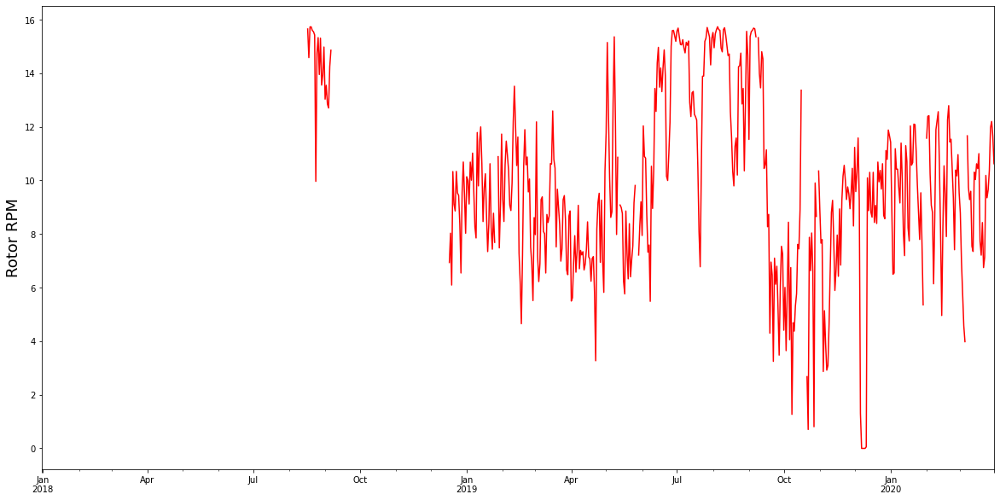

In [20]:
df['RotorRPM'].resample('D').mean().plot(color='red')
plt.ylabel('Rotor RPM', fontsize=18)

data missing to much not good in visualized 

Text(0, 0.5, 'Active pPower and Wind speed*100')

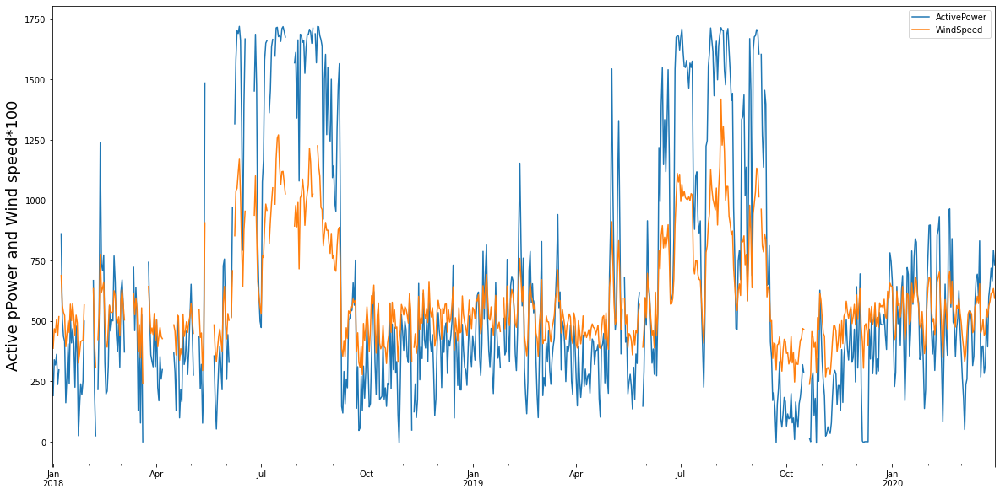

In [21]:
# Graph together
df['ActivePower'].resample('D').mean().plot(legend=True)
(df['WindSpeed']*100).resample('D').mean().plot(legend=True)
plt.ylabel('Active pPower and Wind speed*100', fontsize=18)

Text(0, 0.5, 'Active pPower and Wind speed*100')

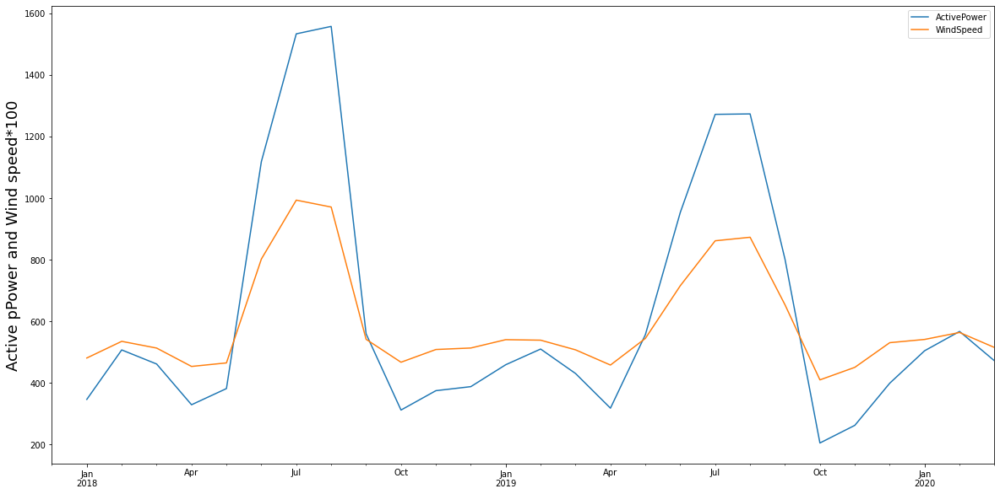

In [22]:
# Graph together
df['ActivePower'].resample('M').mean().plot(legend=True)
(df['WindSpeed']*100).resample('M').mean().plot(legend=True)
plt.ylabel('Active pPower and Wind speed*100', fontsize=18)

In [23]:
# Drop WTG column as it is always G01
df.drop('WTG', axis=1, inplace=True)
df.drop('ControlBoxTemperature', axis=1, inplace=True)

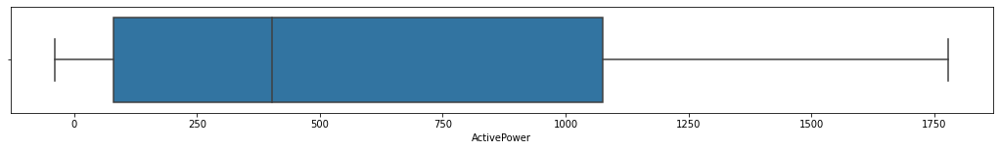

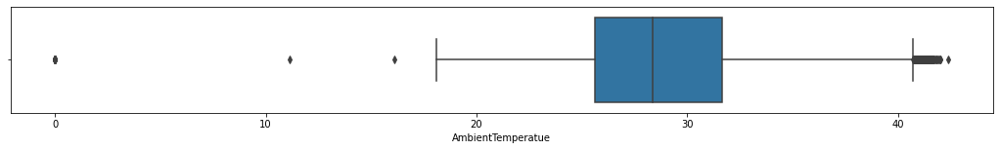

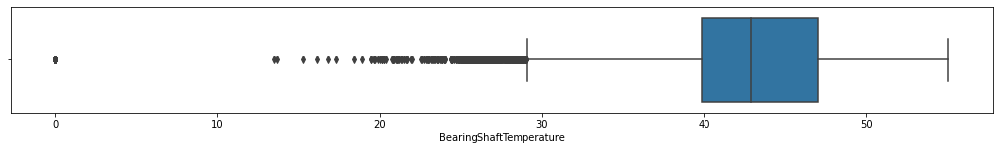

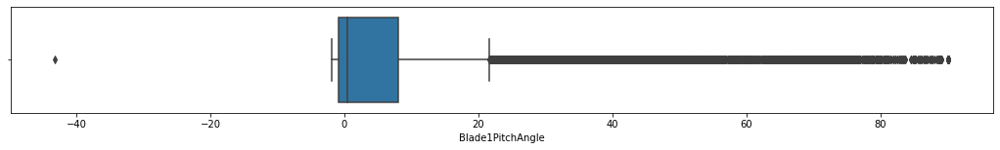

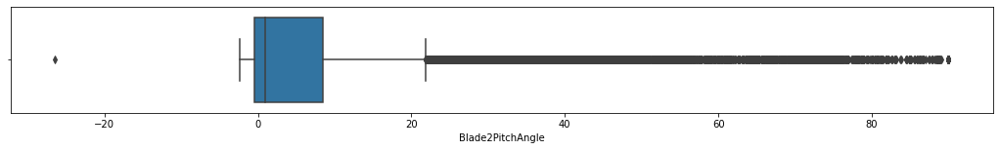

...

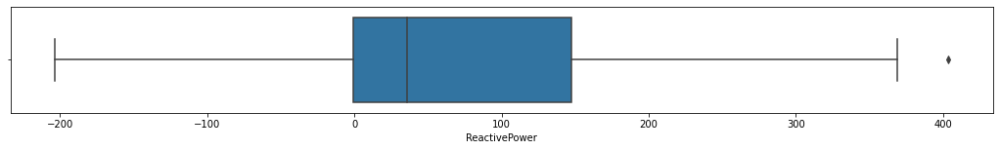

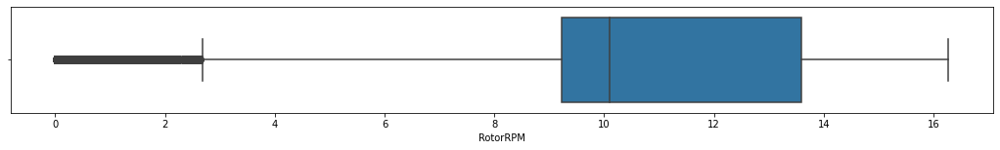

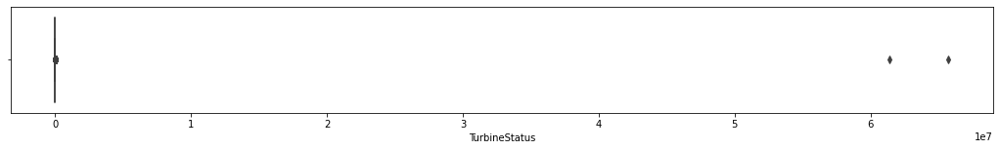

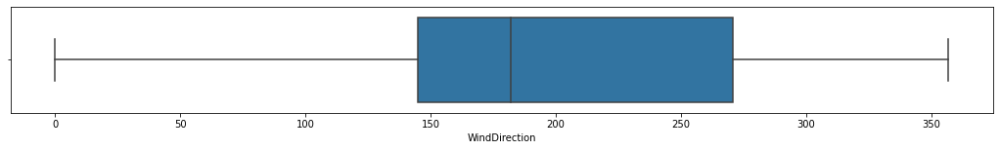

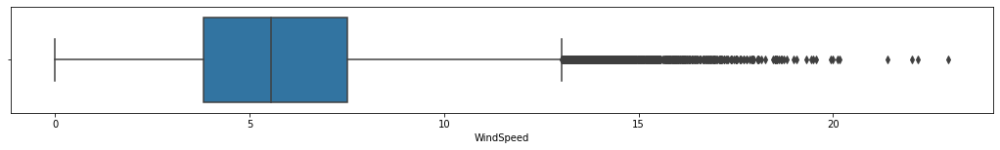

In [24]:
# Boxplots of all the data
for column in df:    
    fig,ax = plt.subplots(figsize=(18,2))
    sns.boxplot(data=df, x=column) 
    

In [25]:
df.columns

Index(['ActivePower', 'AmbientTemperatue', 'BearingShaftTemperature',
       'Blade1PitchAngle', 'Blade2PitchAngle', 'Blade3PitchAngle',
       'GearboxBearingTemperature', 'GearboxOilTemperature', 'GeneratorRPM',
       'GeneratorWinding1Temperature', 'GeneratorWinding2Temperature',
       'HubTemperature', 'MainBoxTemperature', 'NacellePosition',
       'ReactivePower', 'RotorRPM', 'TurbineStatus', 'WindDirection',
       'WindSpeed'],
      dtype='object')

Text(0.5, 1.0, 'Monthly boxplots of Power Generated')

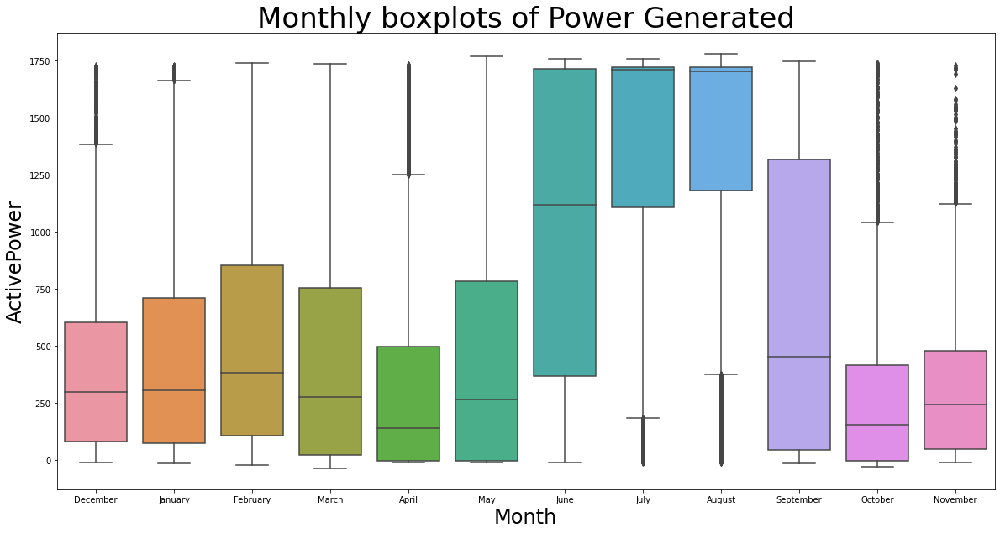

In [26]:
# Now to visualise ActivePower by month
sns.boxplot(x=df.index.month_name(), y='ActivePower', data=df)
plt.ylabel('ActivePower', fontsize=24)
plt.xlabel('Month', fontsize=24)
plt.title("Monthly boxplots of Power Generated", fontsize=34)

Text(0.5, 1.0, 'Monthly boxplots of Wind Speed')

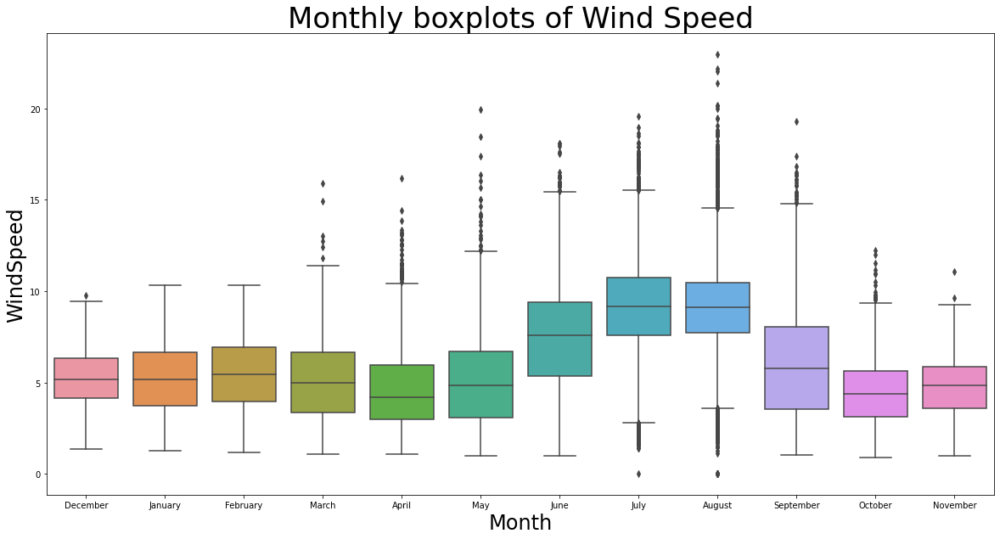

In [27]:
# Now to visualise WindSpeed by month
sns.boxplot(x=df.index.month_name(), y='WindSpeed', data=df)
plt.ylabel('WindSpeed', fontsize=24)
plt.xlabel('Month', fontsize=24)
plt.title("Monthly boxplots of Wind Speed", fontsize=34)

Text(0.5, 1.0, 'Power output versus wind speed')

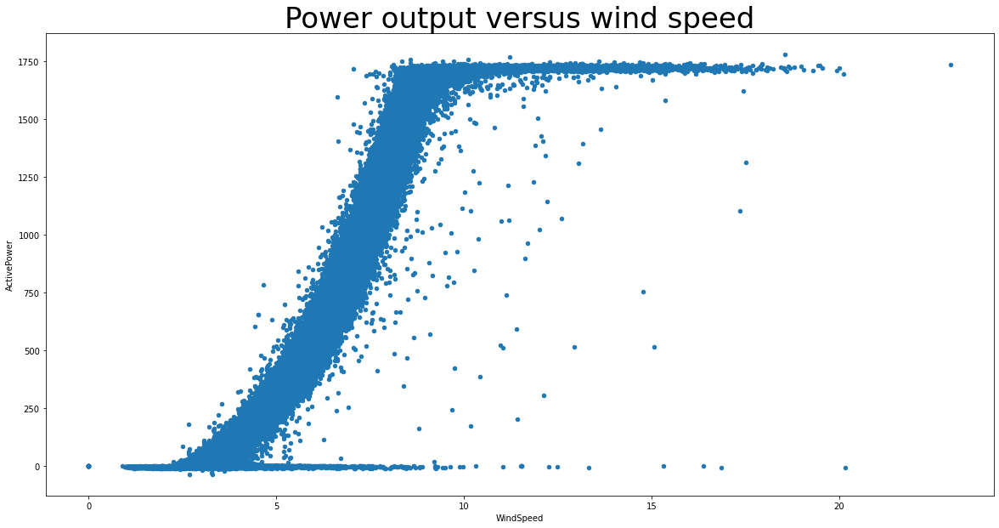

In [28]:
df.plot.scatter(y='ActivePower', x='WindSpeed')
plt.title('Power output versus wind speed', fontsize=34 )

In [29]:
# Look at this for each year to see if more data is missing for different years.
for yr in df.index.year.unique():
    print('\nYear',yr,'\n', df[df.index.year==yr].isna().sum())


Year 2017 
 ActivePower                     144
AmbientTemperatue               144
BearingShaftTemperature         144
Blade1PitchAngle                144
Blade2PitchAngle                144
Blade3PitchAngle                144
GearboxBearingTemperature       144
GearboxOilTemperature           144
GeneratorRPM                    144
GeneratorWinding1Temperature    144
GeneratorWinding2Temperature    144
HubTemperature                  144
MainBoxTemperature              144
NacellePosition                 144
ReactivePower                   144
RotorRPM                        144
TurbineStatus                   144
WindDirection                   144
WindSpeed                       144
dtype: int64

Year 2018 
 ActivePower                     17161
AmbientTemperatue               17157
BearingShaftTemperature         48509
Blade1PitchAngle                52560
Blade2PitchAngle                52560
Blade3PitchAngle                52560
GearboxBearingTemperature       48509
GearboxOilT

### Set final dataframe 
mostly the data highly missing value, we can chose Windspeed as predictor adn ActivePoswer as target

In [30]:
df_final = df[["ActivePower","WindSpeed"]]
df_final

,ActivePower,WindSpeed
2017-12-31 00:00:00+00:00,NaN,NaN
2017-12-31 00:10:00+00:00,NaN,NaN
2017-12-31 00:20:00+00:00,NaN,NaN
2017-12-31 00:30:00+00:00,NaN,NaN
2017-12-31 00:40:00+00:00,NaN,NaN
...,...,...
2020-03-30 23:10:00+00:00,70.044465,3.533445
2020-03-30 23:20:00+00:00,40.833474,3.261231
2020-03-30 23:30:00+00:00,20.777790,3.331839
2020-03-30 23:40:00+00:00,62.091039,3.284468


In [31]:
df_final.dropna(inplace=True)

/home/tsuwega/.pyenv/versions/3.8.5/envs/env_miloo_3.8.5/lib/python3.8/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


In [32]:
df_final

,ActivePower,WindSpeed
2018-01-01 00:00:00+00:00,-5.357727,2.279088
2018-01-01 00:10:00+00:00,-5.822360,2.339343
2018-01-01 00:20:00+00:00,-5.279409,2.455610
2018-01-01 00:30:00+00:00,-4.648054,2.026754
2018-01-01 00:40:00+00:00,-4.684632,1.831420
...,...,...
2020-03-30 23:10:00+00:00,70.044465,3.533445
2020-03-30 23:20:00+00:00,40.833474,3.261231
2020-03-30 23:30:00+00:00,20.777790,3.331839
2020-03-30 23:40:00+00:00,62.091039,3.284468


### Feature Engineering
lets try some feature engineering to create more feature from time series index

In [33]:
def create_features(df):
    """
    Create time series features based on time series index.
    """
    df = df.copy()
    df['hour'] = df.index.hour
    df['dayofweek'] = df.index.dayofweek
    df['quarter'] = df.index.quarter
    df['month'] = df.index.month
    df['year'] = df.index.year
    df['dayofyear'] = df.index.dayofyear
    df['dayofmonth'] = df.index.day
    df['weekofyear'] = df.index.isocalendar().week
    return df

df_final = create_features(df_final)

In [34]:
df_final

,ActivePower,WindSpeed,hour,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear
2018-01-01 00:00:00+00:00,-5.357727,2.279088,0,0,1,1,2018,1,1,1
2018-01-01 00:10:00+00:00,-5.822360,2.339343,0,0,1,1,2018,1,1,1
2018-01-01 00:20:00+00:00,-5.279409,2.455610,0,0,1,1,2018,1,1,1
2018-01-01 00:30:00+00:00,-4.648054,2.026754,0,0,1,1,2018,1,1,1
2018-01-01 00:40:00+00:00,-4.684632,1.831420,0,0,1,1,2018,1,1,1
...,...,...,...,...,...,...,...,...,...,...
2020-03-30 23:10:00+00:00,70.044465,3.533445,23,0,1,3,2020,90,30,14
2020-03-30 23:20:00+00:00,40.833474,3.261231,23,0,1,3,2020,90,30,14
2020-03-30 23:30:00+00:00,20.777790,3.331839,23,0,1,3,2020,90,30,14
2020-03-30 23:40:00+00:00,62.091039,3.284468,23,0,1,3,2020,90,30,14


<AxesSubplot:xlabel='dayofmonth', ylabel='Count'>

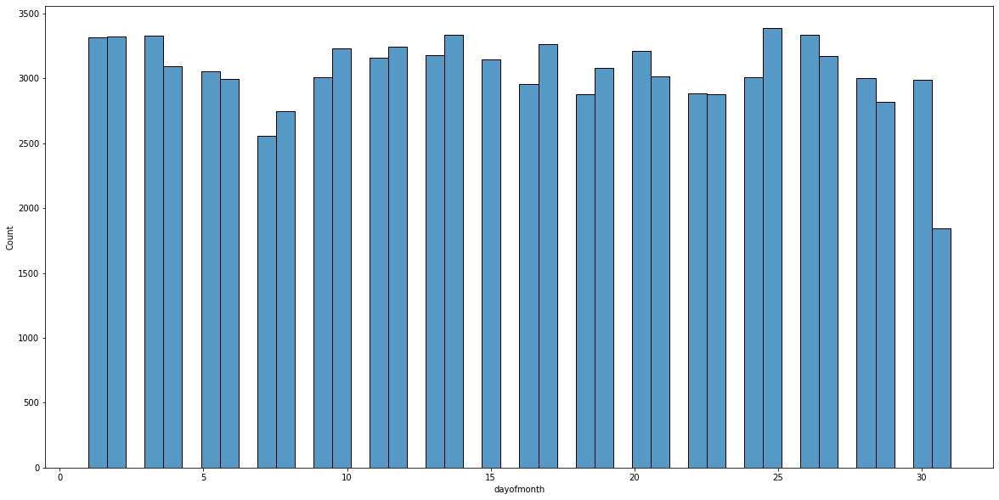

In [35]:
sns.histplot(data=df_final, x="dayofmonth")

<AxesSubplot:xlabel='dayofyear', ylabel='Count'>

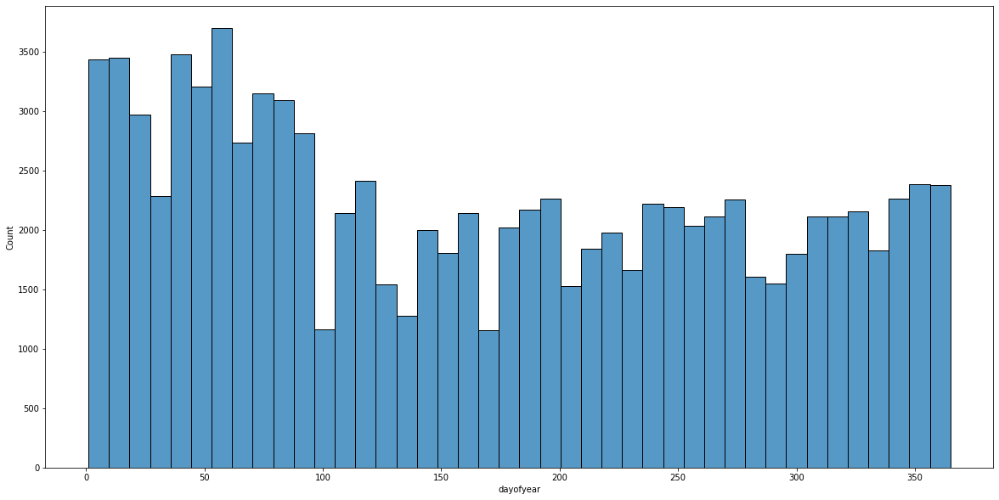

In [36]:
sns.histplot(data=df_final, x="dayofyear")

In [37]:
df_final[df_final["ActivePower"]<0].count()

ActivePower    15638
WindSpeed      15638
hour           15638
dayofweek      15638
quarter        15638
month          15638
year           15638
dayofyear      15638
dayofmonth     15638
weekofyear     15638
dtype: int64

In [38]:
df_final[df_final["ActivePower"]<0]=0

In [39]:
df_final

,ActivePower,WindSpeed,hour,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear
2018-01-01 00:00:00+00:00,0.000000,0.000000,0,0,0,0,0,0,0,0
2018-01-01 00:10:00+00:00,0.000000,0.000000,0,0,0,0,0,0,0,0
2018-01-01 00:20:00+00:00,0.000000,0.000000,0,0,0,0,0,0,0,0
2018-01-01 00:30:00+00:00,0.000000,0.000000,0,0,0,0,0,0,0,0
2018-01-01 00:40:00+00:00,0.000000,0.000000,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...
2020-03-30 23:10:00+00:00,70.044465,3.533445,23,0,1,3,2020,90,30,14
2020-03-30 23:20:00+00:00,40.833474,3.261231,23,0,1,3,2020,90,30,14
2020-03-30 23:30:00+00:00,20.777790,3.331839,23,0,1,3,2020,90,30,14
2020-03-30 23:40:00+00:00,62.091039,3.284468,23,0,1,3,2020,90,30,14


# Model Forecasting

## Split Train Test

In [40]:
df_final.shape

(94436, 10)

In [41]:
df_final.shape[0]/20*100

472180.0

Lets visualize the Active Power Data

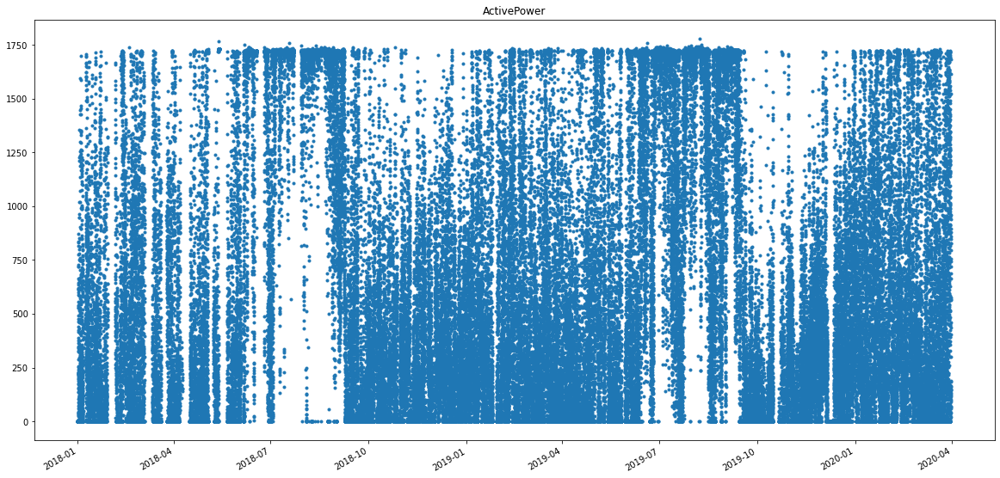

In [42]:
df_final["ActivePower"].plot(style='.',
        title='ActivePower')
plt.show()

Visualized the split data

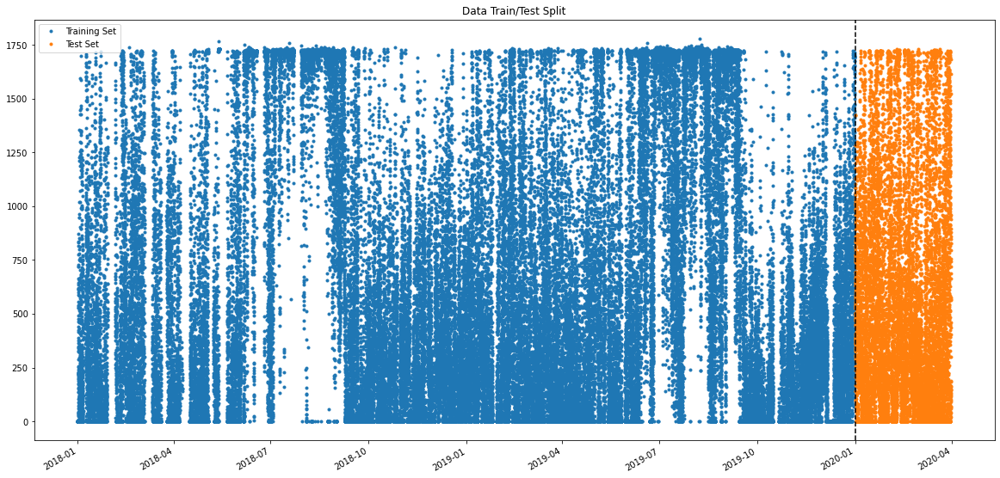

In [43]:
train = df_final["ActivePower"].loc[df_final["ActivePower"].index < '01-01-2020']
test = df_final["ActivePower"].loc[df_final["ActivePower"].index >= '01-01-2020']

fig, ax = plt.subplots()
train.plot(ax=ax, label='Training Set', style='.', title='Data Train/Test Split')
test.plot(ax=ax, label='Test Set', style='.')
ax.axvline('01-01-2020', color='black', ls='--')
ax.legend(['Training Set', 'Test Set'])
plt.show()

In [44]:
train = df_final[df_final["ActivePower"].index < '01-01-2020']
test = df_final[df_final["ActivePower"].index >= '01-01-2020']

In [45]:
df_final.columns.tolist()

['ActivePower',
 'WindSpeed',
 'hour',
 'dayofweek',
 'quarter',
 'month',
 'year',
 'dayofyear',
 'dayofmonth',
 'weekofyear']

In [61]:
# train = create_features(train)
# test = create_features(test)

# FEATURES = ['WindSpeed','dayofyear', 'hour', 'dayofweek', 'quarter', 'month', 'year']
FEATURES = ['WindSpeed']
TARGET = 'ActivePower'

X_train = train[FEATURES]
y_train = train[TARGET]

X_test = test[FEATURES]
y_test = test[TARGET]


## Fit the model

In [62]:
reg = xgb.XGBRegressor(base_score=0.5, booster='gbtree',    
                       n_estimators=1000,
                       early_stopping_rounds=50,
                       objective='reg:linear',
                       max_depth=3,
                       learning_rate=0.01)
reg.fit(X_train, y_train,
        eval_set=[(X_train, y_train), (X_test, y_test)],
        verbose=100)

[22:05:55] WARNING: ../src/objective/regression_obj.cu:171: reg:linear is now deprecated in favor of reg:squarederror.
[22:05:55] WARNING: ../src/learner.cc:573: 
Parameters: { "early_stopping_rounds" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[0]	validation_0-rmse:877.62647	validation_1-rmse:713.68384
[100]	validation_0-rmse:330.50659	validation_1-rmse:274.67960
[200]	validation_0-rmse:140.75287	validation_1-rmse:123.23357
[300]	validation_0-rmse:87.78001	validation_1-rmse:80.09818
[400]	validation_0-rmse:77.87655	validation_1-rmse:70.58966
[500]	validation_0-rmse:76.41021	validation_1-rmse:68.53673
[600]	validation_0-rmse:76.15178	validation_1-rmse:68.00659
[700]	validation_0-rmse:76.09006	validation_1-rmse:67.85448
[800]	validation_0-rmse:75.99536	validation_1-rmse:67.

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, early_stopping_rounds=50,
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.01, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=12,
             num_parallel_tree=1, objective='reg:linear', random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

visualized the prediction result

/tmp/ipykernel_1599/423156621.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['prediction'] = reg.predict(X_test)


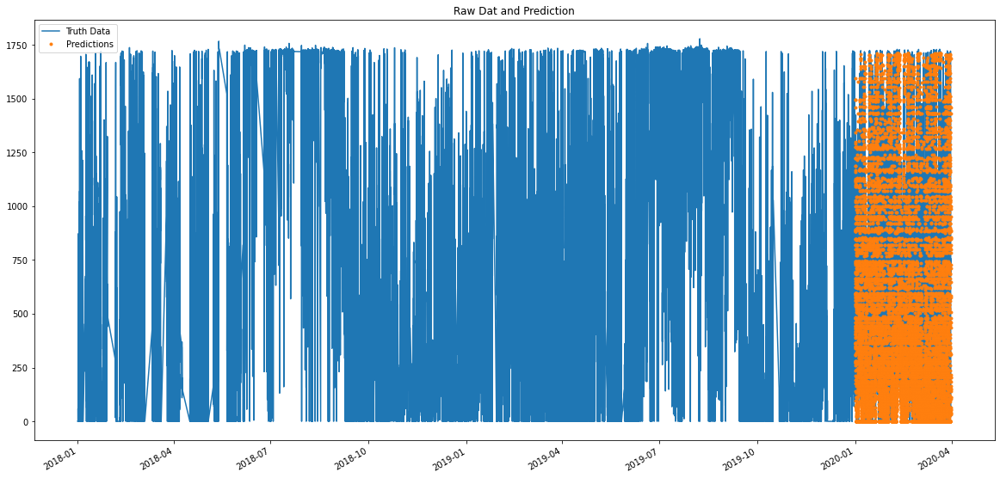

In [63]:
test['prediction'] = reg.predict(X_test)
df_pred = df_final.merge(test[['prediction']], how='left', left_index=True, right_index=True)
ax = df_pred[['ActivePower']].plot()
df_pred['prediction'].plot(ax=ax, style='.')
plt.legend(['Truth Data', 'Predictions'])
ax.set_title('Raw Dat and Prediction')
plt.show()

# reg.predict(X_test)

In [64]:
X_test.head(4)

,WindSpeed
2020-01-01 00:00:00+00:00,5.547000
2020-01-01 00:10:00+00:00,6.375833
2020-01-01 00:20:00+00:00,7.099773
2020-01-01 00:30:00+00:00,7.366228


visualized the prediction result week of data

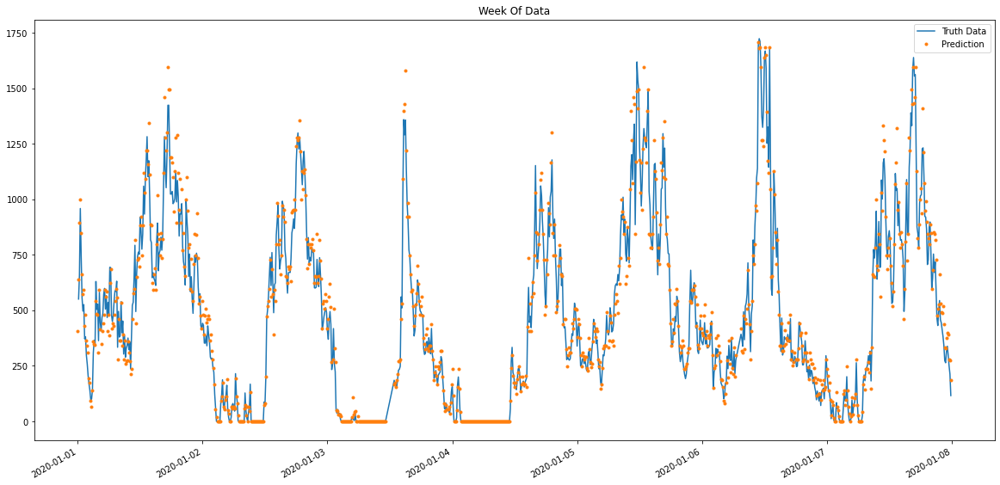

In [65]:
ax = df_final.loc[(df_final.index > '01-01-2020') & (df_final.index < '01-08-2020')]['ActivePower'].plot(title='Week Of Data')
test.loc[(test.index > '04-01-2018') & (test.index < '01-08-2020')]['prediction'].plot(style='.')
plt.legend(['Truth Data','Prediction'])
plt.show()

In [66]:
score = np.sqrt(mean_squared_error(test['ActivePower'], test['prediction']))
print(f'RMSE Score on Test set: {score:0.2f}')

RMSE Score on Test set: 67.78


## Save model

In [67]:
# Save as JSON file
# reg.save_model("model.json")
reg.save_model("API/models/model.json")

In [68]:
X_test[0:1]

,WindSpeed
2020-01-01 00:00:00+00:00,5.547


In [69]:
X_test.iloc[1]

WindSpeed    6.375833
Name: 2020-01-01 00:10:00+00:00, dtype: float64

In [70]:
np.array(X_test.iloc[1])

array([6.37583311])

In [73]:
xbg_reg = xgb.XGBRegressor()
xbg_reg.load_model("API/models/model.json")
xbg_reg.predict(np.array(X_test))

array([404.9428  , 638.91656 , 893.20715 , ...,  41.468067,  36.72211 ,
        50.295956], dtype=float32)

In [74]:
xbg_reg.predict(np.array([6.375833]))

array([638.91656], dtype=float32)

In [ ]:
xbg_reg.predict(np.array([[6.37583311e+00, 1.00000000e+00, 0.00000000e+00, 2.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 2.02000000e+03]]))

array([573.1532], dtype=float32)

In [ ]:
preds = xbg_reg.predict(np.array([6.375833]))
preds[0]

638.91656

In [ ]:
 69.18 # without windspeed
 65.30 # all
 67.78 # windspeed only

65.3

In [ ]:
reg.predict(np.array(X_test.iloc[1]))

array([638.91656], dtype=float32)